In [1]:
# Import the required libraries and dependencies
import panel as pn
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import random
import hvplot.pandas
import holoviews as hv
from pathlib import Path
from panel.template import DarkTheme
from uszipcode import SearchEngine  # To convert zipcode prefix to latitude and longitude
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

import geopandas as gpd

C:\Users\Kuitche\anaconda3\envs\dev\lib\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [2]:
# Create a path to the file and read into a dataframe
pathname = Path("Resources/Data/Loan_data.csv")
loan_data = pd.read_csv(pathname)

# Purpose and Data Source
The purpose of this part of the project is twofolds:  
(1) To determine those features, other that the credit score, that affect the interest rate on a loan  
(2) to predict whether or not a borrower is at risk of defaulting on a loan based on some characteristics.   

We focus on microloans.
We define Microloans as loans that do not exceed 100,000 USD. 
The dataset used, Loan_data.csv, was downloaded from Kragle and represent loans from LendingTree, which provides a very large, open dataset on  people who received loans through their platform 

# Data Cleansing process
Print all the columns to scan through and identify features of interest
Managing columns: combining and renaming some columns as described in the data description
Extracting the columns of interest


In [3]:
# browse the columns in the dataset to select the of interest
for col in loan_data.columns:
    print(col)

Unnamed: 0
member_id
loan_amnt
funded_amnt
funded_amnt_inv
term
int_rate
installment
grade
sub_grade
emp_title
emp_length
home_ownership
annual_inc
verification_status
issue_d
loan_status
pymnt_plan
url
desc
purpose
title
zip_code
addr_state
dti
delinq_2yrs
earliest_cr_line
fico_range_low
fico_range_high
inq_last_6mths
mths_since_last_delinq
mths_since_last_record
open_acc
pub_rec
revol_bal
revol_util
total_acc
initial_list_status
out_prncp
out_prncp_inv
total_pymnt
total_pymnt_inv
total_rec_prncp
total_rec_int
total_rec_late_fee
recoveries
collection_recovery_fee
last_pymnt_d
last_pymnt_amnt
next_pymnt_d
last_credit_pull_d
last_fico_range_high
last_fico_range_low
collections_12_mths_ex_med
mths_since_last_major_derog
policy_code
application_type
annual_inc_joint
dti_joint
verification_status_joint
acc_now_delinq
tot_coll_amt
tot_cur_bal
open_acc_6m
open_act_il
open_il_12m
open_il_24m
mths_since_rcnt_il
total_bal_il
il_util
open_rv_12m
open_rv_24m
max_bal_bc
all_util
total_rev_hi_lim
i

In [4]:
# Checking the different application types
# Loan applications are classified as either individual or joint applications
loan_data['application_type'].unique()

array(['Individual', 'Joint App', nan], dtype=object)

In [5]:
# We focus on individual application type
individual_loans = loan_data.loc[loan_data['application_type'] == 'Individual']
individual_loans.head()

,Unnamed: 0,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,13,NaN,18000.0,18000.0,18000.0,60 months,19.48,471.70,E,E2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,25,NaN,4225.0,4225.0,4225.0,36 months,14.85,146.16,C,C5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,30,NaN,16000.0,16000.0,16000.0,36 months,12.88,538.18,C,C2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,31,NaN,24250.0,24250.0,24250.0,60 months,24.24,701.01,F,F3,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,33,NaN,25000.0,25000.0,25000.0,60 months,13.99,581.58,C,C4,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Features of the borrower and the loan
borrower_features = ['loan_status', 'public_record', 'fico', 'revol_util', 'revol_bal', 'home_ownership', 'log_annual_inc', 'hardship_flag', 'delinq_2yrs', 'dti', 'mths_since_last_delinq', 'emp_length', 'zip_code', 'addr_state']
hardship = ['hardship_flag', 'hardship_type', 'hardship_status', 'hardship_reason']
loan_info = ['log_loan_amnt', 'term', 'int_rate', 'purpose'] 

In [7]:
# Checking that the loan amount in the dataset meets our definition of micro loans
# Otherwise, we'll need to slice it
print(f"Max: {individual_loans['loan_amnt'].max()}\nMin: {individual_loans['loan_amnt'].min()}")

Max: 40000.0
Min: 500.0


In [8]:
# Combining and renaming the columns
# The natural log of the loan amount is used in the analysis: log_loan_amount = np.log(loan_amount)
individual_loans['log_loan_amnt'] = np.log(individual_loans['loan_amnt'])
# the natural log of the income is used in the analysis: log_annual_inc = np.log(annual_inc)
individual_loans['log_annual_inc'] = np.log(individual_loans['annual_inc'])
# fico = last_fico_range_low: the FICO credit score of the borrower
individual_loans['fico'] = individual_loans['last_fico_range_low']
# pub_rec = "tax_liens" + "pub_rec_bankruptcies"
individual_loans['public_record'] = individual_loans['tax_liens'] + individual_loans['pub_rec_bankruptcies']


In [9]:
# Extracting the columns of interest
columns = loan_info + borrower_features
loan_features = individual_loans[columns]
loan_features.head()

,log_loan_amnt,term,int_rate,purpose,loan_status,public_record,fico,revol_util,revol_bal,home_ownership,log_annual_inc,hardship_flag,delinq_2yrs,dti,mths_since_last_delinq,emp_length,zip_code,addr_state
0,9.798127,60 months,19.48,debt_consolidation,Charged Off,1.0,580.0,40.7,14052.0,RENT,11.918391,N,0.0,9.39,NaN,7 years,916xx,CA
1,8.348775,36 months,14.85,debt_consolidation,Charged Off,0.0,0.0,24.6,1058.0,RENT,10.463103,N,2.0,15.22,18.0,5 years,672xx,KS
2,9.680344,36 months,12.88,small_business,Charged Off,1.0,625.0,54.3,5157.0,MORTGAGE,11.082143,N,0.0,18.96,33.0,10+ years,354xx,AL
3,10.096172,60 months,24.24,debt_consolidation,Charged Off,0.0,0.0,65.3,24799.0,MORTGAGE,11.225243,N,0.0,20.84,NaN,4 years,114xx,NY
4,10.126631,60 months,13.99,debt_consolidation,Charged Off,0.0,600.0,18.6,22519.0,MORTGAGE,11.277203,N,0.0,34.53,NaN,9 years,212xx,MD


In [10]:
# Checking the structure of the data fields
# Drop null data
loan_features.dropna(inplace=True)
# Data types
loan_features.dtypes

log_loan_amnt             float64
term                       object
int_rate                  float64
purpose                    object
loan_status                object
public_record             float64
fico                      float64
revol_util                float64
revol_bal                 float64
home_ownership             object
log_annual_inc            float64
hardship_flag              object
delinq_2yrs               float64
dti                       float64
mths_since_last_delinq    float64
emp_length                 object
zip_code                   object
addr_state                 object
dtype: object

## Checking Data Structure
We observe that the *term*, *emp_length*, and *zip_code* are objects. They should have been numeric.
A quick inspection of each field reveals the following formats:
1. **term**: number + "months
2. **emp_length**: num + "years" with length over 10 years provided in the format "10+" + "years"
3. **zip_code**: 3 digit prefix + "xx"

The following refinement was applied:
* Only 2 terms are reported; either 36 months or 60 months. It will be maintain as a categorical variable
* emp_length: We will remove any non-digits character after the number; meaning 10+ years will be considered 10 years.
* zip_code: we will remove the xx

In [11]:
loan_features['emp_length']

1            5 years
2          10+ years
9            3 years
10           4 years
13           7 years
             ...    
1007973      9 years
1007974    10+ years
1007975      5 years
1007983    10+ years
1007984      6 years
Name: emp_length, Length: 455652, dtype: object

In [12]:
# Field Refinement
# Refining emp_length column
el = loan_features['emp_length'].str.split(pat=" ", expand=True)  # Split by the space
el[0].replace("\\D","", regex=True, inplace=True) # Now remove any non-digit character
loan_features['emp_length'] = el[0].replace('', np.NaN) # Replace empty value with NaN
loan_features.dropna(inplace=True)  # Drop all the nulls
loan_features['emp_length'] = loan_features['emp_length'].astype('int')  # and convert to integer type
loan_features['emp_length']

1           5
2          10
9           3
10          4
13          7
           ..
1007973     9
1007974    10
1007975     5
1007983    10
1007984     6
Name: emp_length, Length: 421469, dtype: int32

In [13]:
# Refining zip_code column
loan_features['zip_code'] = loan_features['zip_code'].str.replace("x","")
loan_features

,log_loan_amnt,term,int_rate,purpose,loan_status,public_record,fico,revol_util,revol_bal,home_ownership,log_annual_inc,hardship_flag,delinq_2yrs,dti,mths_since_last_delinq,emp_length,zip_code,addr_state
1,8.348775,36 months,14.85,debt_consolidation,Charged Off,0.0,0.0,24.6,1058.0,RENT,10.463103,N,2.0,15.22,18.0,5,672,KS
2,9.680344,36 months,12.88,small_business,Charged Off,1.0,625.0,54.3,5157.0,MORTGAGE,11.082143,N,0.0,18.96,33.0,10,354,AL
9,9.680344,60 months,8.49,credit_card,In Grace Period,0.0,690.0,51.2,15763.0,MORTGAGE,11.034890,N,0.0,28.92,39.0,3,936,CA
10,9.903488,60 months,13.99,debt_consolidation,Charged Off,0.0,620.0,42.0,31200.0,OWN,11.156251,N,0.0,16.90,33.0,4,210,MD
13,10.047588,60 months,20.50,car,Charged Off,0.0,580.0,94.9,20594.0,OWN,11.608236,N,0.0,20.43,47.0,7,197,DE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1007973,9.903488,60 months,15.59,renewable_energy,Fully Paid,5.0,700.0,60.8,12949.0,MORTGAGE,12.083905,N,0.0,12.36,62.0,9,950,CA
1007974,9.680344,60 months,10.99,debt_consolidation,Fully Paid,0.0,735.0,7.6,5995.0,MORTGAGE,11.695247,N,1.0,12.40,10.0,10,112,NY
1007975,9.323669,60 months,13.49,debt_consolidation,Charged Off,2.0,0.0,54.7,12581.0,RENT,11.362103,N,0.0,4.80,75.0,5,981,WA
1007983,9.680344,60 months,12.79,medical,Fully Paid,3.0,680.0,55.0,7700.0,RENT,11.918391,N,0.0,12.25,68.0,10,284,NC


In [14]:
# We now attempt to identify correlations among the features of the borrower
# Correlation values greater or equal to 10% will be considered significant
correlation_matrix = loan_features.corr()
correlation_matrix

,log_loan_amnt,int_rate,public_record,fico,revol_util,revol_bal,log_annual_inc,delinq_2yrs,dti,mths_since_last_delinq,emp_length
log_loan_amnt,1.000000,0.160192,-0.030989,0.017656,0.115064,0.244930,0.427620,0.004627,0.029110,-0.017885,0.075228
int_rate,0.160192,1.000000,0.036273,-0.213134,0.187541,-0.021921,-0.082349,0.033678,0.169851,-0.031790,-0.001043
public_record,-0.030989,0.036273,1.000000,-0.044434,-0.056981,-0.064383,0.005223,-0.036929,-0.036230,0.072644,0.007194
fico,0.017656,-0.213134,-0.044434,1.000000,-0.063490,0.055415,0.090174,-0.026275,-0.065135,0.016149,0.031333
revol_util,0.115064,0.187541,-0.056981,-0.063490,1.000000,0.228458,0.085095,-0.017454,0.161763,0.017805,0.051559
revol_bal,0.244930,-0.021921,-0.064383,0.055415,0.228458,1.000000,0.322502,-0.008827,0.117716,-0.015212,0.068965
log_annual_inc,0.427620,-0.082349,0.005223,0.090174,0.085095,0.322502,1.000000,0.055921,-0.247622,-0.064877,0.104292
delinq_2yrs,0.004627,0.033678,-0.036929,-0.026275,-0.017454,-0.008827,0.055921,1.000000,-0.004931,-0.558152,0.006915
dti,0.029110,0.169851,-0.036230,-0.065135,0.161763,0.117716,-0.247622,-0.004931,1.000000,0.010259,0.029438
mths_since_last_delinq,-0.017885,-0.031790,0.072644,0.016149,0.017805,-0.015212,-0.064877,-0.558152,0.010259,1.000000,-0.009786


<AxesSubplot:>

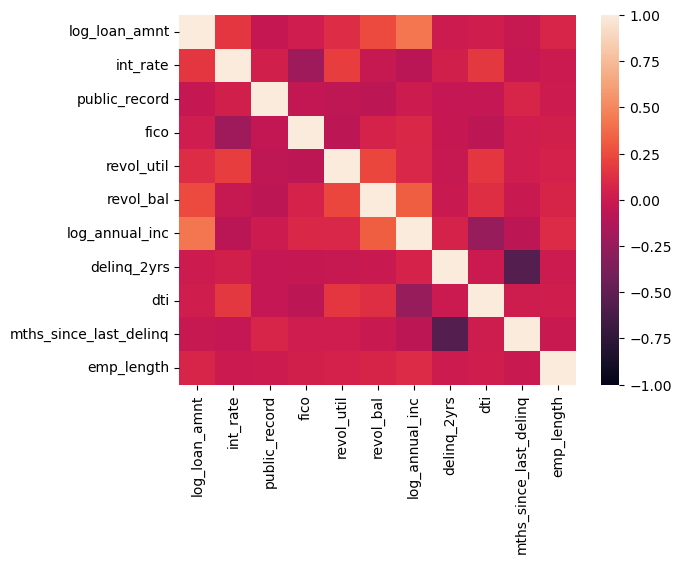

In [15]:
# Correlation Heatmap
sns.heatmap(correlation_matrix, vmin=-1, vmax=1)

## Correlation among borrower features
Looking at the correlation matrix an dthe heatmap, we observe the following correlations:
* Very strong negative correlation between the number of delinquencies the past 2 years and the number of months since last delinquency. We'll ignore the *mths_since_last_delinq* from further analysis.  
* Strong negative correlation between *dti* and *log_annual_inc*. Logically, the higher the income, the lower the debt-to-income ratio. We can ignore the log_annual_inc.
* Significant correlation between *fico score* and *interest rate*. The credit score is usually used by lenders to decide whether or not to grant a loan, or to decide an interest rate on a loan. Because our goal is to explore other  path, we will remove the fico score from the analysis.

In [16]:
# Removing the variables identified above, we can now update the list of features
borrower_features = ['loan_status', 'public_record', 'revol_util', 'revol_bal', 'home_ownership', 'hardship_flag', 'delinq_2yrs', 'dti', 'emp_length', 'zip_code', 'addr_state']

## Features, other that the credit score, that affect the interest rate on a loan
### Loan amount vs Interest Rate vs Terms vs Purpose
Let's first look at how the total loans are distributed across the different purposes.
The pie charts below show that:
- Debt consolidation seems to be the major reason for loans, followed by credit card, then home improvement.
- The purpose of individual loans has no significant effect on the interest rates
- While the majority (more than 50%) of loans are received by home owners followed by renters, home ownership doesn't seem to affect the interest rate

In [17]:
loan_info_df = loan_features[loan_info]
loan_info_df

,log_loan_amnt,term,int_rate,purpose
1,8.348775,36 months,14.85,debt_consolidation
2,9.680344,36 months,12.88,small_business
9,9.680344,60 months,8.49,credit_card
10,9.903488,60 months,13.99,debt_consolidation
13,10.047588,60 months,20.50,car
...,...,...,...,...
1007973,9.903488,60 months,15.59,renewable_energy
1007974,9.680344,60 months,10.99,debt_consolidation
1007975,9.323669,60 months,13.49,debt_consolidation
1007983,9.680344,60 months,12.79,medical


<AxesSubplot:title={'center':'Distribution of loans by purposes'}>

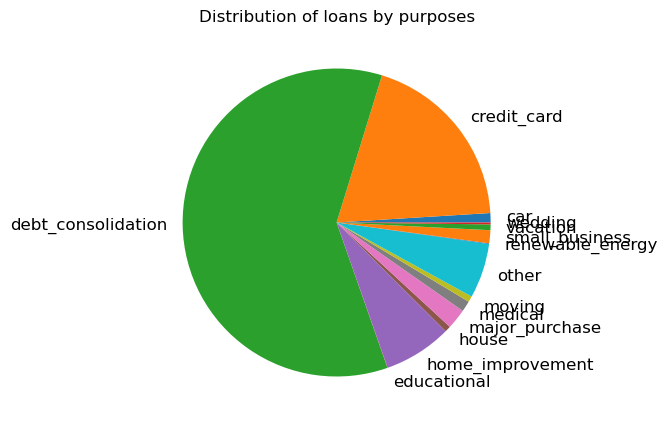

In [18]:
# cummulative loan amount vs vs Purpose
loan_purpose = loan_info_df.groupby("purpose").sum()
loan_purpose.plot.pie(y="log_loan_amnt", legend=False, title="Distribution of loans by purposes", figsize=(5,5), fontsize=12, ylabel='')

<AxesSubplot:title={'center':'Distribution of interest rate by purposes'}>

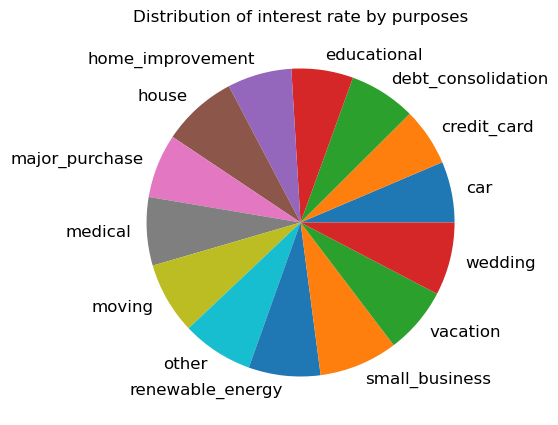

In [19]:
# Median interest rate vs vs Purpose
loan_rate = loan_info_df.groupby("purpose").median()
loan_rate.plot.pie(y="int_rate", legend=False, title="Distribution of interest rate by purposes", figsize=(5,5), fontsize=12, ylabel='')

In [20]:
# Loan amount vs interest rate 
loan_info_df.hvplot.scatter(x='int_rate', y='log_loan_amnt', by='term', legend='top', height=500)

:NdOverlay   [term]
   :Scatter   [int_rate]   (log_loan_amnt)

<AxesSubplot:title={'center':'Distribution of loans by home ownership'}>

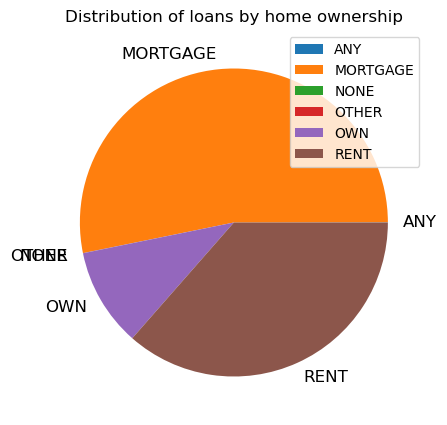

In [21]:
# cummulative loan amount vs home ownership
loan_home = loan_features.groupby("home_ownership").sum()
loan_home.plot.pie(y="log_loan_amnt", legend=True, title="Distribution of loans by home ownership", figsize=(5,5), fontsize=12, ylabel='')

<AxesSubplot:title={'center':'Distribution of interest rate by home ownership'}>

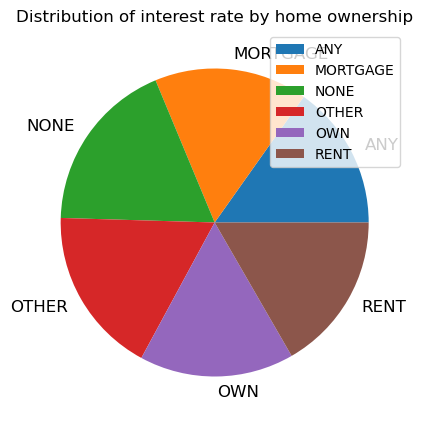

In [22]:
# Median Interest Rate vs home ownership
loan_home = loan_features.groupby("home_ownership").median()
loan_home.plot.pie(y="int_rate", legend=True, title="Distribution of interest rate by home ownership", figsize=(5,5), fontsize=12, ylabel='')

## How do the features of a borrower affect the loan interest rate?
Looping through the features, we plot below the median rate vs the given feature. It can be observed that:
* There is no discernable trend between the interest rate and the number of public records, home ownership, and length of employment
* The higher the amount of the credit line used relative to total credit available, the higher the interest rate on a loan; same trend with the debt to income ratio
* When an account has been delinquent for 25+ months during the past 2 years, the interest rate is higher
* The rates are slightly higher for people with hardship and those loans not fully paid.

In [23]:
# Looping through the features and ploting the median interest rates vs each feature
borrower_features = ['loan_status', 'public_record', 'revol_util', 'revol_bal', 'home_ownership', 'hardship_flag', 'delinq_2yrs', 'dti', 'emp_length']
for f in borrower_features:
    loan_x = loan_features.groupby(f).agg(median_rate=("int_rate", 'median'))
    display(loan_x.hvplot.bar(y='median_rate', legend='top', rot=45, height=500))
    

:Bars   [loan_status]   (median_rate)

:Bars   [public_record]   (median_rate)

:Bars   [revol_util]   (median_rate)

:Bars   [revol_bal]   (median_rate)

:Bars   [home_ownership]   (median_rate)

:Bars   [hardship_flag]   (median_rate)

:Bars   [delinq_2yrs]   (median_rate)

:Bars   [dti]   (median_rate)

:Bars   [emp_length]   (median_rate)

In [24]:
# Loan amount vs interest rate 
#loan_features.hvplot.scatter(y='int_rate', x='public_record', by='hardship_flag', xlim=(0,20), legend='top', height=500)
#loan_features.plot.scatter(y="int_rate", x='public_record', by='hardship_flag', xlim=(0,20), legend=True)
#loan_x = loan_features.groupby(["loan_status"],).agg(median_rate=("int_rate", 'median'))
#loan_x = loan_x.reset_index()
#loan_x.hvplot.scatter(x="delinq_2yrs", y="median_rate", by="emp_length")
#sns.barplot(x="delinq_2yrs", y="median_rate", hue="emp_length", data=loan_x.loc[loan_x["loan_status"]=="At Risk"])
#loan_x.hvplot.bar(y='median_rate', legend='top', rot=45, height=500)

## Predicting Default
A borrower's loan status indicates whether or not he/she has defaulted, fully paid, late, etc.  
We'll assume two levels:
* **Fully Paid** if the loan has been paid in full.
* **At Risk** otherwise    
The previous analyzes confirm that the debt-to-income ratio is somewhat correlated to the number of revolvng account utilization. Thus, the revol_util can safely be discarded.

In [25]:
# Let's assume that all loans not fully paid are at risk; which includes defaults and late payments
borrower_features = ['int_rate', 'loan_status', 'public_record', 'home_ownership', 'hardship_flag', 'delinq_2yrs', 'dti', 'emp_length', 'zip_code']
loan_status = loan_features[borrower_features]
loan_status.loc[loan_status["loan_status"].str.contains("Fully Paid"), "loan_status"] ="Fully Paid"
loan_status.loc[loan_status["loan_status"].str.contains("Fully Paid")==False, "loan_status"] ="At Risk"
loan_status

,int_rate,loan_status,public_record,home_ownership,hardship_flag,delinq_2yrs,dti,emp_length,zip_code
1,14.85,At Risk,0.0,RENT,N,2.0,15.22,5,672
2,12.88,At Risk,1.0,MORTGAGE,N,0.0,18.96,10,354
9,8.49,At Risk,0.0,MORTGAGE,N,0.0,28.92,3,936
10,13.99,At Risk,0.0,OWN,N,0.0,16.90,4,210
13,20.50,At Risk,0.0,OWN,N,0.0,20.43,7,197
...,...,...,...,...,...,...,...,...,...
1007973,15.59,Fully Paid,5.0,MORTGAGE,N,0.0,12.36,9,950
1007974,10.99,Fully Paid,0.0,MORTGAGE,N,1.0,12.40,10,112
1007975,13.49,At Risk,2.0,RENT,N,0.0,4.80,5,981
1007983,12.79,Fully Paid,3.0,RENT,N,0.0,12.25,10,284


In [26]:
# Also, home ownership is either RENT, OWN, or OTHER. MORTGAGE == OWN
loan_status.loc[loan_status["home_ownership"].isin(["MORTGAGE", "OWN"]), "home_ownership"] ="OWN"
loan_status.loc[loan_status["home_ownership"].str.contains("RENT"), "home_ownership"] ="RENT"
loan_status.loc[loan_status["home_ownership"].isin(["MORTGAGE", "OWN", "RENT"])==False, "home_ownership"] ="OTHER"
loan_status

,int_rate,loan_status,public_record,home_ownership,hardship_flag,delinq_2yrs,dti,emp_length,zip_code
1,14.85,At Risk,0.0,RENT,N,2.0,15.22,5,672
2,12.88,At Risk,1.0,OWN,N,0.0,18.96,10,354
9,8.49,At Risk,0.0,OWN,N,0.0,28.92,3,936
10,13.99,At Risk,0.0,OWN,N,0.0,16.90,4,210
13,20.50,At Risk,0.0,OWN,N,0.0,20.43,7,197
...,...,...,...,...,...,...,...,...,...
1007973,15.59,Fully Paid,5.0,OWN,N,0.0,12.36,9,950
1007974,10.99,Fully Paid,0.0,OWN,N,1.0,12.40,10,112
1007975,13.49,At Risk,2.0,RENT,N,0.0,4.80,5,981
1007983,12.79,Fully Paid,3.0,RENT,N,0.0,12.25,10,284


In [27]:
# Let's plot for each loan status 
loan_at_risk = loan_status.drop(columns=['int_rate'])
loan_at_risk = loan_status.loc[loan_status["loan_status"]=="At Risk"]
loan_paid = loan_status.loc[loan_status["loan_status"]=="Fully Paid"]
loan_at_risk.drop(columns=['loan_status'], inplace=True)
loan_paid.drop(columns=['loan_status'], inplace=True)
loan_at_risk = loan_at_risk.groupby(["hardship_flag", "home_ownership"]).agg(total_delinq=('delinq_2yrs', 'sum'), total_records=("public_record", "sum"), average_dti=("dti", "mean"),average_emp=("emp_length", "mean"))
loan_paid = loan_paid.groupby(["hardship_flag", "home_ownership"]).agg(total_delinq=('delinq_2yrs', 'sum'), total_records=("public_record", "sum"), average_dti=("dti", "mean"),average_emp=("emp_length", "mean"))

for var in ['total_delinq', 'total_records', 'average_dti', 'average_emp']:
    loan_at_risk_plot = loan_at_risk[var].hvplot.bar(rot=90, width=1000, yaxis='left', color='red')
    loan_paid_plot = loan_paid[var].hvplot.bar(rot=90, width=1000, yaxis='right', color='green')
    display(loan_at_risk_plot * loan_paid_plot)


:Overlay
   .Bars.Total_delinq.I  :Bars   [hardship_flag,home_ownership]   (total_delinq)
   .Bars.Total_delinq.II :Bars   [hardship_flag,home_ownership]   (total_delinq)

:Overlay
   .Bars.Total_records.I  :Bars   [hardship_flag,home_ownership]   (total_records)
   .Bars.Total_records.II :Bars   [hardship_flag,home_ownership]   (total_records)

:Overlay
   .Bars.Average_dti.I  :Bars   [hardship_flag,home_ownership]   (average_dti)
   .Bars.Average_dti.II :Bars   [hardship_flag,home_ownership]   (average_dti)

:Overlay
   .Bars.Average_emp.I  :Bars   [hardship_flag,home_ownership]   (average_emp)
   .Bars.Average_emp.II :Bars   [hardship_flag,home_ownership]   (average_emp)

"At Risk" loans are in red and "Fully Paid" in green
It cam be observed that:
* Loans at risk are function of the average debt-to-income ratio and number of years of employment.
* People with hardships are more riskier.
* Higher average DTI is very risky, whether or not one has hardship, own or rent a home; and it is surprisingly riskier for people without hardship

In [28]:
# Loan status vs debt-to-income ratio
loan_status_box = loan_status[["int_rate", "dti", "public_record", "delinq_2yrs", "loan_status"]]
y = ["dti", "public_record", "delinq_2yrs"]
loan_status_box.hvplot.box('dti', by='loan_status', width=2000)

:BoxWhisker   [loan_status]   (dti)

In [29]:
# loan status vs interest rate
# The mean/median rate is obviously higher for riskier loans
loan_status_box.hvplot.box('int_rate', by='loan_status')

:BoxWhisker   [loan_status]   (int_rate)

In [30]:
# Loan status vs. past 2 years delinquency
# Not much influence on the loan status
loan_status_box.hvplot.box('delinq_2yrs', by='loan_status')

:BoxWhisker   [loan_status]   (delinq_2yrs)

In [31]:
# Loan status vs. number of derogatory records
# Not much influence on the loan status
loan_status_box.hvplot.box('public_record', by='loan_status')

:BoxWhisker   [loan_status]   (public_record)

In [32]:
# Using interest rate as metric, let's check its distribution
# This appears approximately normally distributed
loan_status.hvplot.hist("int_rate")

:Histogram   [int_rate]   (int_rate_count)

In [33]:
loan_rates = loan_status.pivot_table(values="int_rate", index="dti", columns="loan_status")
loan_rates

loan_status,At Risk,Fully Paid
dti,,
-1.00,NaN,9.750000
0.00,15.803953,13.509779
0.01,6.000000,15.716667
0.02,14.440000,12.967500
0.04,NaN,13.350000
...,...,...
49.77,NaN,17.270000
49.81,NaN,17.970000
49.86,21.180000,20.750000


In [34]:
weights = [0.6, 0.4]
loan_returns = loan_rates.dot(weights)
loan_returns

dti
-1.00           NaN
 0.00     14.886284
 0.01      9.886667
 0.02     13.851000
 0.04           NaN
            ...    
 49.77          NaN
 49.81          NaN
 49.86    21.008000
 49.94          NaN
 49.95          NaN
Length: 4480, dtype: float64

In [35]:
volatility = loan_rates.std() * np.sqrt(252)
volatility

loan_status
At Risk       32.519699
Fully Paid    33.035752
dtype: float64

<AxesSubplot:xlabel='dti'>

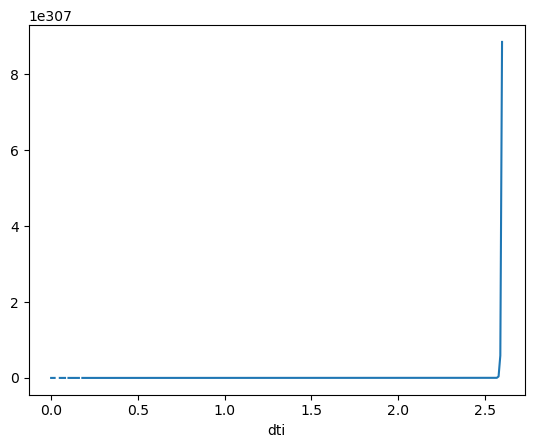

In [36]:
# Higher Volalitity Portfolio (More risk, but potentially higher returns)
initial_investment = 10000
weights = [0.6, 0.4]  # Let's use a conventional 60/40 portfolio
loan_returns = loan_rates.dot(weights)
cumulative_returns = (1 + loan_returns).cumprod()
(initial_investment * cumulative_returns).plot()

In [37]:
# Evaluate Reward-to-Risk (Sharpe Ratio)
sharpe_ratios = (loan_rates.mean() * 252) / (loan_rates.std() * np.sqrt(252))
sharpe_ratios

loan_status
At Risk       125.629322
Fully Paid    108.229048
dtype: float64

The debt-to-income ratio was used as index for risk analysis.
While the volatility doesn't reveal much, the sharpe ratio points out to an opportunity for investors to take a risk, as the reward to risk ratio is much higher for riskier loans

In [38]:
# Visualize the distribution of interest rates across all loan statuses using a density plot
loan_rates.hvplot.kde(y=["At Risk", "Fully Paid"])

:NdOverlay   [loan_status]
   :Distribution   [value]   (Density)

## Now let's vizualize the locations


In [39]:
loan_status

,int_rate,loan_status,public_record,home_ownership,hardship_flag,delinq_2yrs,dti,emp_length,zip_code
1,14.85,At Risk,0.0,RENT,N,2.0,15.22,5,672
2,12.88,At Risk,1.0,OWN,N,0.0,18.96,10,354
9,8.49,At Risk,0.0,OWN,N,0.0,28.92,3,936
10,13.99,At Risk,0.0,OWN,N,0.0,16.90,4,210
13,20.50,At Risk,0.0,OWN,N,0.0,20.43,7,197
...,...,...,...,...,...,...,...,...,...
1007973,15.59,Fully Paid,5.0,OWN,N,0.0,12.36,9,950
1007974,10.99,Fully Paid,0.0,OWN,N,1.0,12.40,10,112
1007975,13.49,At Risk,2.0,RENT,N,0.0,4.80,5,981
1007983,12.79,Fully Paid,3.0,RENT,N,0.0,12.25,10,284


### Where are they located?
We see that loans to people without hardship but having higher debt-to-income ratio would be much riskier.
Let's look at their geographical locations.
The data shows that zip code prefixes of 090 and above are all over the places; thus not reliable. We'll get rid of them   
The data contains unused zip code prefixes and prefixes for non-US states (such as Washington DC or Puerto Rico). These will be removed

In [40]:
# At-Risk loans with no hardship
riskier_loans = loan_status.loc[(loan_status["loan_status"]=="At Risk") & (loan_status["hardship_flag"]=="N")]
riskier_loans = riskier_loans[["int_rate", "dti", "emp_length", "zip_code"]]
riskier_loans

,int_rate,dti,emp_length,zip_code
1,14.85,15.22,5,672
2,12.88,18.96,10,354
9,8.49,28.92,3,936
10,13.99,16.90,4,210
13,20.50,20.43,7,197
...,...,...,...,...
1007966,12.79,9.65,2,290
1007971,13.49,14.44,10,101
1007972,13.99,29.89,10,799
1007975,13.49,4.80,5,981


In [41]:
# Reset the index
riskier_loans.reset_index(drop=True, inplace=True)
riskier_loans

,int_rate,dti,emp_length,zip_code
0,14.85,15.22,5,672
1,12.88,18.96,10,354
2,8.49,28.92,3,936
3,13.99,16.90,4,210
4,20.50,20.43,7,197
...,...,...,...,...
128457,12.79,9.65,2,290
128458,13.49,14.44,10,101
128459,13.99,29.89,10,799
128460,13.49,4.80,5,981


In [42]:
# Convert zip code prefixes to latitudes and longitudes 
engine = SearchEngine()
riskier_loans['latitude'] = np.NaN  # set the new columns to NaN so unused columns can later be dropped
riskier_loans['longitude'] = np.NaN
for i in riskier_loans.index:
    try:
        riskier_loans.loc[i, "latitude"] = engine.by_prefix(riskier_loans.loc[i, "zip_code"])[0].lat
        riskier_loans.loc[i, "longitude"] = engine.by_prefix(riskier_loans.loc[i, "zip_code"])[0].lng
    except IndexError as e:
        pass   # Ignoring the errors due to invalid zipcode prefixes

riskier_loans

,int_rate,dti,emp_length,zip_code,latitude,longitude
0,14.85,15.22,5,672,37.68,-97.34
1,12.88,18.96,10,354,33.17,-87.62
2,8.49,28.92,3,936,37.39,-119.73
3,13.99,16.90,4,210,39.51,-76.17
4,20.50,20.43,7,197,39.58,-75.68
...,...,...,...,...,...,...
128457,12.79,9.65,2,290,33.76,-80.15
128458,13.49,14.44,10,101,40.76,-73.98
128459,13.99,29.89,10,799,31.76,-106.48
128460,13.49,4.80,5,981,47.61,-122.33


In [43]:
# Dropping NaN
riskier_loans.dropna(inplace=True)

In [44]:
world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

In [45]:
us_chart = world[world["name"] == "United States of America"].hvplot(
                            color="snow",
                            width=950,height=500,
                            title='Geo-Location of Riskier Loans')


riskier_loans_chart = riskier_loans.hvplot.points(
    'longitude', 
    'latitude',
    xlabel = 'Longitude',
    ylabel = 'Latitude',
    cmap="YlOrRd",
    color='int_rate',
    size='dti',
    alpha=0.8,
    width=950,height=500,
    geo=True,
    tiles='OSM'
    )

riskier_loans_chart


:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [longitude,latitude]   (int_rate,dti)